In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt


from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

In [2]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

## Dataset 1: Main Song Dataset (170,653 rows)
### What it Contains:
1. Individual track-level data.
2. Detailed audio features: danceability, energy, valence, acousticness, etc.
3. Metadata: name, year, artists, explicit, popularity, release_date, etc.

### Purpose:
1. Core dataset for clustering and recommendations.
2. Used to train the song-level KMeans model and build PCA projections.
3. Acts as the search base for recommending similar songs.

### Usage in Project:
1. Content-based recommendation engine uses this to:
2. Extract song features
3. Compute similarities
4. Recommend tracks

In [3]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

## Dataset 2: Genre-Level Dataset (2,973 rows)
### What it Contains:
1. Each row is a genre.
2. Columns are average audio features for that genre (e.g., average valence, tempo, energy, etc.)
3. Genre name in genres column.

###  Purpose:
1. Understanding similarity between genres using clustering + t-SNE.
2. Not track-specific — more of a bird’s-eye view of music style clusters.

### Usage in Project:
1. Clustering (KMeans with 10 clusters) was applied.
2. t-SNE visualization created an interactive genre map.
3. Helpful in seeing how genres group together (e.g., are rap and trap close? Is classical isolated?).

In [4]:
print(genre_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB
None


## Dataset 3: Small Sample Dataset (100 rows)
### What it Contains:
Same format as the main song dataset.

Only 100 entries.

Includes year, audio features, popularity, mode, key, etc.

### Purpose:
Likely a test or validation set.

Could be used for:

    Testing recommendation results

    Building playlists

    Creating mock user input

    Evaluation/debugging

### Usage in Project:

You could use it as a controlled set of known songs to test how well recommendations match expectations.



In [5]:
print(year_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB
None


## Genre-Based Clustering (Using KMeans) on data_by_genres.csv

In [6]:
from sklearn.pipeline import make_pipeline
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

cluster_pipeline = make_pipeline(StandardScaler(), KMeans(n_clusters=10))
genre_data['cluster'] = cluster_pipeline.fit_predict(genre_data.select_dtypes(include=[np.number]))

### t-SNE Visualization of Genre Clusters

In [7]:
from sklearn.manifold import TSNE
from sklearn.manifold import TSNE
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import pandas as pd
import plotly.express as px

# Create a pipeline and apply t-SNE transformation in one step
tsne_pipeline = make_pipeline(StandardScaler(), TSNE(n_components=2, verbose=1, random_state=42))
projection = pd.DataFrame(tsne_pipeline.fit_transform(genre_data.select_dtypes(include=[np.number])),
                          columns=['x', 'y'])
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

# Create the scatter plot
fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['genres'])
fig.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.016s...
[t-SNE] Computed neighbors for 2973 samples in 0.381s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.818185
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.823219
[t-SNE] KL divergence after 1000 iterations: 1.150645


## Song-Based Clustering (Using KMeans on data.csv Dataset)

In [8]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                  ('kmeans', KMeans(n_clusters=20,
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

### PCA Visualization of Song Clusters

In [9]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()


## Fetching Song Features from Spotify API

In [10]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='e718060be300434d8b02a4451b37ecd7',
                                                           client_secret='4f2506ae10714d9c9f3ba30d2884b476'))


def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

## Recommendation Logic: Matching Songs via Feature Similarity

In [11]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):

    try:
        song_data = spotify_data[(spotify_data['name'] == song['name'])
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data

    except IndexError:
        return find_song(song['name'], song['year'])


def get_mean_vector(song_list, spotify_data):

    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):

    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []

    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):

    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

examples:
1. Frosty the Snowman 1979
2. Dynamite 2020
3. just like magic 2020

### Example Recommendation Call

In [12]:
recommend_songs([{'name': 'Dynamite', 'year':2020}],  data)

[{'name': 'Levitating (feat. DaBaby)',
  'year': 2020,
  'artists': "['Dua Lipa', 'DaBaby']"},
 {'name': 'Dance with Me (feat. Thomas Rhett & Young Thug)',
  'year': 2020,
  'artists': "['Diplo', 'Thomas Rhett', 'Young Thug']"},
 {'name': 'Telepathy', 'year': 2020, 'artists': "['BTS']"},
 {'name': "DJ Got Us Fallin' In Love (feat. Pitbull)",
  'year': 2010,
  'artists': "['Usher', 'Pitbull']"},
 {'name': 'Sugar (feat. Francesco Yates)',
  'year': 2015,
  'artists': "['Robin Schulz', 'Francesco Yates']"},
 {'name': 'Blue Hour', 'year': 2020, 'artists': "['TOMORROW X TOGETHER']"},
 {'name': 'My House', 'year': 2015, 'artists': "['Flo Rida']"},
 {'name': 'Levitating (feat. DaBaby)',
  'year': 2020,
  'artists': "['Dua Lipa', 'DaBaby']"}]

## Mood Based Recommendation

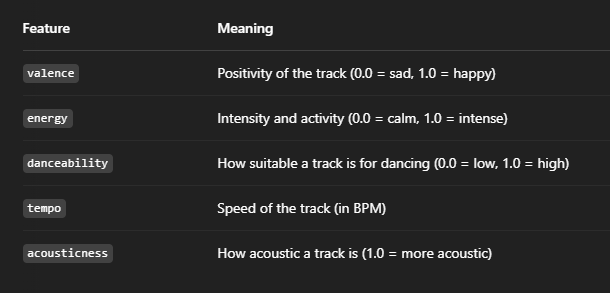

In [13]:
# Define mood profiles using average feature values
mood_profiles = {
    "happy": {
        "valence": 0.8,
        "energy": 0.7,
        "danceability": 0.7,
        "tempo": 120,
        "acousticness": 0.2
    },
    "chill": {
        "valence": 0.4,
        "energy": 0.3,
        "danceability": 0.4,
        "tempo": 90,
        "acousticness": 0.8
    },
    "party": {
        "valence": 0.7,
        "energy": 0.9,
        "danceability": 0.9,
        "tempo": 125,
        "acousticness": 0.1
    },
    "sad": {
        "valence": 0.2,
        "energy": 0.3,
        "danceability": 0.3,
        "tempo": 80,
        "acousticness": 0.6
    },
    "romantic": {
        "valence": 0.6,
        "energy": 0.4,
        "danceability": 0.5,
        "tempo": 90,
        "acousticness": 0.7
    },
    "focus": {
        "valence": 0.3,
        "energy": 0.2,
        "danceability": 0.3,
        "tempo": 60,
        "acousticness": 0.9
    },
    "workout": {
        "valence": 0.6,
        "energy": 0.95,
        "danceability": 0.85,
        "tempo": 130,
        "acousticness": 0.1
    },
    "relax": {
        "valence": 0.5,
        "energy": 0.3,
        "danceability": 0.4,
        "tempo": 70,
        "acousticness": 0.8
    },
    "aggressive": {
        "valence": 0.2,
        "energy": 0.95,
        "danceability": 0.6,
        "tempo": 140,
        "acousticness": 0.05
    },
    "uplifting": {
        "valence": 0.9,
        "energy": 0.8,
        "danceability": 0.6,
        "tempo": 110,
        "acousticness": 0.3
    }
}

def recommend_by_mood(mood_tag, spotify_data, n_recs=10):
    if mood_tag not in mood_profiles:
        print(f"Unsupported mood: {mood_tag}. Choose from {list(mood_profiles.keys())}")
        return []

    mood_vector = np.array([mood_profiles[mood_tag][col] for col in ['valence', 'energy', 'danceability', 'tempo', 'acousticness']])
    mood_data = spotify_data[['valence', 'energy', 'danceability', 'tempo', 'acousticness']].copy()
    
    distances = cdist([mood_vector], mood_data.values, metric='euclidean')
    indices = np.argsort(distances[0])[:n_recs]

    return spotify_data.iloc[indices][['name', 'year', 'artists']].to_dict(orient='records')


MOOD OPTIONS AVAILABLE:
- happy
- chill
- party
- sad
- romantic
- focus
- workout
- relax
- aggressive
- uplifting

In [14]:
recommend_by_mood("party", data, n_recs=5)

[{'name': 'My Ballz - The Longest Yard Soundtrack (Explicit)',
  'year': 2005,
  'artists': "['D12']"},
 {'name': 'We No Speak Americano (JT Radio Edit)',
  'year': 2010,
  'artists': "['Yolanda Be Cool', 'DCup', 'JT']"},
 {'name': 'Hot Chocolate', 'year': 2004, 'artists': "['Tom Hanks']"},
 {'name': 'Ring Ding Dong', 'year': 2009, 'artists': "['SHINee']"},
 {'name': 'Karma - Robert Garcia Rare Work',
  'year': 2013,
  'artists': "['JUST2', 'Robert Garcia']"}]

## Playlist Generation

### CLI for song input

In [15]:
def collect_user_songs():
    print("🎵 Enter songs to build your playlist. Format: Song Name, Year")
    print("Type 'done' when finished.\n")
    user_songs = []

    while True:
        entry = input("Enter song: ")
        if entry.lower() == 'done':
            break
        try:
            name, year = entry.rsplit(',', 1)
            user_songs.append({'name': name.strip(), 'year': int(year.strip())})
        except:
            print("⚠️ Invalid format. Please use: Song Name, Year")

    return user_songs

In [16]:
def generate_playlist_songs(seed_songs, spotify_data, n_recommendations=10):
    recommendations = recommend_songs(seed_songs, spotify_data, n_songs=n_recommendations)
    return recommendations

In [17]:
def print_playlist(user_songs, recommended_songs):
    print("\n Your Personalized Playlist:\n")

    print("🟩 Seed Songs:")
    for i, song in enumerate(user_songs, 1):
        print(f"{i}. {song['name']} ({song['year']})")

    print("\n🟨 Recommended Songs:")
    for i, song in enumerate(recommended_songs, 1):
        print(f"{i}. {song['name']} ({song['year']}) - {song['artists']}")


In [20]:
def run_playlist_generator():
    user_songs = collect_user_songs()
    if not user_songs:
        print("⚠️ No songs entered.")
        return

    recommended_songs = generate_playlist_songs(user_songs, data)
    print_playlist(user_songs, recommended_songs)

# Run this function to use the CLI playlist generator
run_playlist_generator()

🎵 Enter songs to build your playlist. Format: Song Name, Year
Type 'done' when finished.



HTTP Error for GET to https://api.spotify.com/v1/audio-features/?ids=79ubxs8BHf9qyXs2EddiHy with Params: {} returned 403 due to None


SpotifyException: http status: 403, code:-1 - https://api.spotify.com/v1/audio-features/?ids=79ubxs8BHf9qyXs2EddiHy:
 None, reason: None